<a href="https://colab.research.google.com/github/pavanreddyml/SquadCon-Workshop-2025/blob/main/01_Image_Attacks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hands On Adversarial Attacks

# Setup

In [ ]:
!pip install adversarial-lab

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.3/97.3 kB 5.1 MB/s eta 0:00:00


In [ ]:
!git clone https://github.com/pavanreddyml/SquadCon-Workshop-2025.git

Cloning into 'SquadCon-Workshop-2025'...
remote: Enumerating objects: 47, done.
remote: Counting objects: 100% (47/47), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 47 (delta 1), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (47/47), 1.67 MiB | 4.39 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [ ]:
from adversarial_lab.core.optimizers import PGD
from adversarial_lab.core.losses import CategoricalCrossEntropy
from adversarial_lab.attacker.whitebox import WhiteBoxMisclassification
from adversarial_lab.core.noise_generators import AdditiveNoiseGenerator
from adversarial_lab.core.preprocessing import PreprocessingFromFunction
from adversarial_lab.core.constraints import POClip, PONoisedSampleBounding
from adversarial_lab.callbacks import EarlyStopping
from adversarial_lab.arsenal.whitebox import *

from adversarial_lab.utils import Plotting

import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras.preprocessing import image

In [ ]:
MODEL = "InceptionV3"     # Supported models: InceptionV3, ResNet50, MobileNetV2, Digits
IMAGES_DIR = os.path.join("SquadCon-Workshop-2025", "data", "animals")     # Directory containing the images
MODEL_DIR = os.path.join("SquadCon-Workshop-2025", "models")               # Directory containing the model

In [ ]:
if MODEL == "InceptionV3":
    from tensorflow.keras.applications import InceptionV3
    from tensorflow.keras.applications.inception_v3 import preprocess_input, decode_predictions
    model = InceptionV3(weights='imagenet')
    input_shape = (299, 299, 3)
elif MODEL == "ResNet50":
    from tensorflow.keras.applications import ResNet50
    from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
    model = ResNet50(weights='imagenet')
    input_shape = (224, 224, 3)
elif MODEL == "MobileNetV2":
    from tensorflow.keras.applications import MobileNetV2
    from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
    model = MobileNetV2(weights='imagenet')
    input_shape = (224, 224, 3)
else:
  raise ValueError(f"Unsupported Model: {MODEL}")

96112376/96112376 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
def preprocess(sample, *args, **kwargs):
    input_sample = tf.cast(sample, dtype=tf.float32)
    if len(input_sample.shape) == 2:
        input_sample = tf.expand_dims(input_sample, axis=-1)
        input_sample = tf.image.grayscale_to_rgb(input_sample)

    elif len(input_sample.shape) == 3 and input_sample.shape[-1] == 1:
        input_sample = tf.image.grayscale_to_rgb(input_sample)

    input_tensor = tf.convert_to_tensor(input_sample, dtype=tf.float32)
    resized_image = tf.image.resize(input_tensor, input_shape[:2])
    batch_image = tf.expand_dims(resized_image, axis=0)
    return preprocess_input(batch_image)

In [ ]:
def get_image_array(image_path):
    image = Image.open(image_path)
    image_array = np.array(image)
    return image_array

# Whitebox Attacks

## Fast Sign Gradient Method (FSGM)



This notebook cell runs an adversarial attack using the Fast Sign Gradient Method (FSGM) on a given input image and visualizes the results. Below is a detailed explanation of the configuration parameters used at the top of the cell.

## Attack Overview

The **Fast Sign Gradient Method (FSGM)** is a *white-box*, *gradient-based* adversarial attack technique. It perturbs the input image in the direction of the sign of the gradient of the loss with respect to the input pixels. The goal is to force a misclassification by the model with minimal perturbation that is imperceptible to the human eye.

Mathematically, the perturbed image `x'` is computed as:

  **x' = x + ε * sign(∇ₓ J(θ, x, y_target))**

Where:
- `x` is the original input image.
- `ε` (epsilon) controls the perturbation magnitude.
- `∇ₓ J(θ, x, y_target)` is the gradient of the loss function with respect to the input.
- `y_target` is the target class in a targeted attack (or true class in untargeted).
- `sign()` ensures only the direction of the gradient is used, not its magnitude.

This method is computationally efficient and widely used for testing model robustness.

## Parameters

| Parameter      | Type     | Description |
|----------------|----------|-------------|
| `IMAGE`        | `str`    | Filename of the input image to be attacked. |
| `EPSILON`      | `int`    | Magnitude of the perturbation added to the image for the attack. Determines the strength of the adversarial noise. |
| `EPSILONS`     | `list`   | List of epsilon values for potential use in sweeping or multiple experiments. Not used in the specific attack in this cell. |
| `TARGET_CLASS` | `int`    | Target class index for the targeted attack. The model will be tricked into classifying the image as this class. |
| `ON_ORIGINAL`  | `bool`   | If True, the attack is applied on the original (non-preprocessed) image. If False, it is applied after preprocessing. |
| `VERBOSE`      | `int`    | Verbosity level. If set to 1 or higher, the attack will print detailed logs during execution. |


In [ ]:
IMAGE = "panda.jpg"
EPSILON = 2
EPSILONS = [1, 2, 5, 10, 20, 50, 100]
TARGET_CLASS = 207
ON_ORIGINAL = True
VERBOSE = 1

In [ ]:
image_path = os.path.join(IMAGES_DIR, IMAGE)
image_array = get_image_array(image_path)

In [ ]:
predictions = model.predict(preprocess(image_array), verbose=0)
print("Predicted class:", decode_predictions(predictions, top=1)[0][0][1])
print("Predicted class index:", np.argmax(predictions, axis=1)[0])
print("Predicted class probability:", np.max(predictions, axis=1)[0])

35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Predicted class: giant_panda
Predicted class index: 388
Predicted class probability: 0.91791797


Attacking: 100%|██████████| 1/1 [00:03<00:00,  3.60s/it]

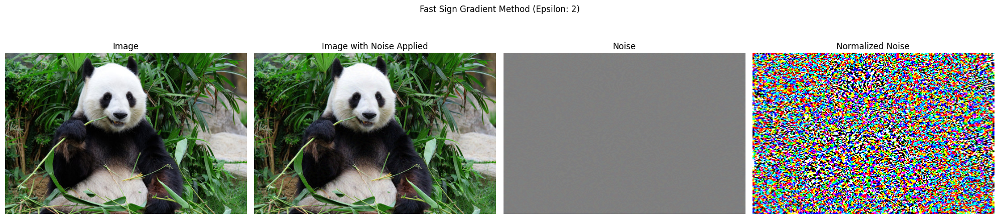

In [ ]:
attacker = FastSignGradientMethodAttack(
    model=model,
    preprocessing_fn=PreprocessingFromFunction.create(preprocess),
    epsilon=float(EPSILON),
    binary=False,
    verbose=VERBOSE,
)

noise, noise_meta = attacker.attack(
    sample=image_array,
    target_class=TARGET_CLASS,
    on_original=ON_ORIGINAL, # This determines if the attack is performed on the original image or on the preprocessed one
)

Plotting.plot_images_and_noise(image_array,
                               noise,
                               config={
                                   "title": f"Fast Sign Gradient Method (Epsilon: {EPSILON})",
                               })

In [ ]:
print(
    f"Epsilon: {EPSILON}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n",
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
)

Epsilon: 2
Original class: 388
Target class: 207
Adversarial class: 388
 Noise min: -2.0
Noise max: 2.0



Epsilon: 1
Original class: 388
Target class: 207
Adversarial class: 388
Noise min: -1.0
Noise max: 1.0
Noise mean: 0.00042866941657848656



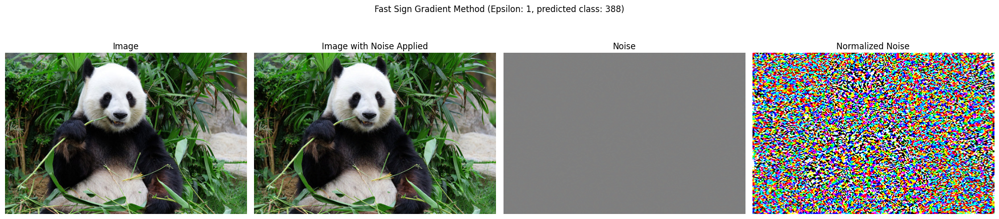

Epsilon: 2
Original class: 388
Target class: 207
Adversarial class: 388
Noise min: -2.0
Noise max: 2.0
Noise mean: 0.0008573388331569731



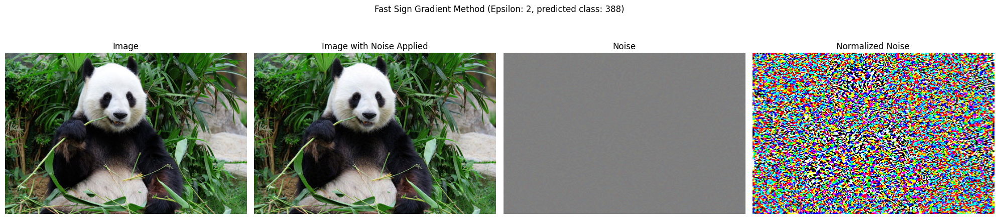

Epsilon: 5
Original class: 388
Target class: 207
Adversarial class: 388
Noise min: -5.0
Noise max: 5.0
Noise mean: 0.0021433469373732805



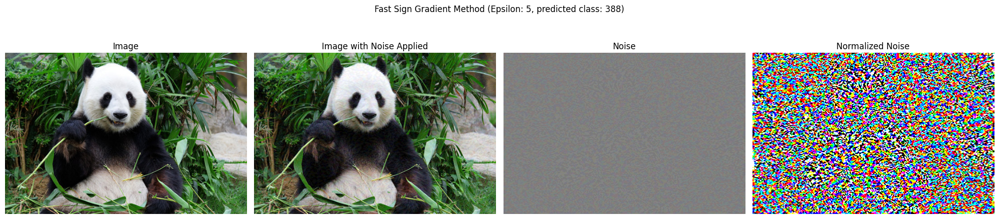

Epsilon: 10
Original class: 388
Target class: 207
Adversarial class: 388
Noise min: -10.0
Noise max: 10.0
Noise mean: 0.004286693874746561



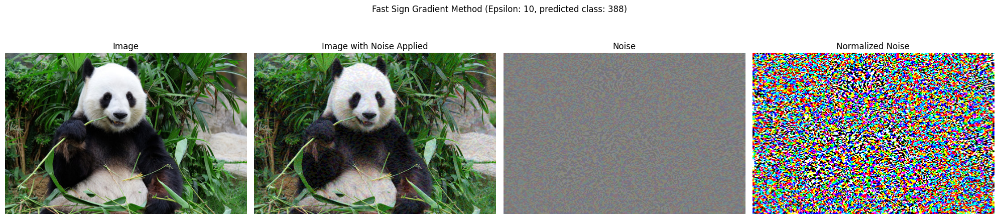

Epsilon: 20
Original class: 388
Target class: 207
Adversarial class: 388
Noise min: -20.0
Noise max: 20.0
Noise mean: 0.008573387749493122



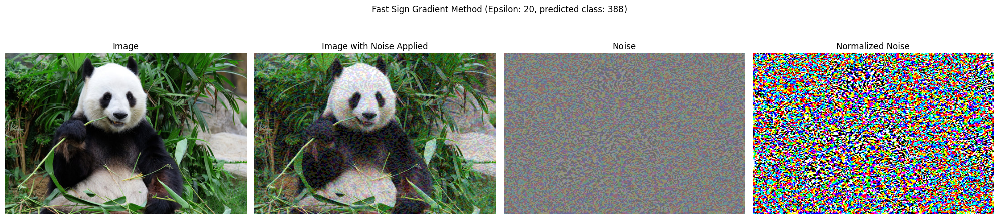

Epsilon: 50
Original class: 388
Target class: 207
Adversarial class: 279
Noise min: -50.0
Noise max: 50.0
Noise mean: 0.021433470770716667



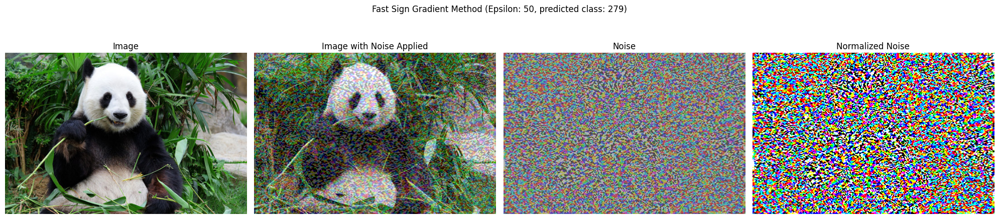

Epsilon: 100
Original class: 388
Target class: 207
Adversarial class: 892
Noise min: -100.0
Noise max: 100.0
Noise mean: 0.042866941541433334



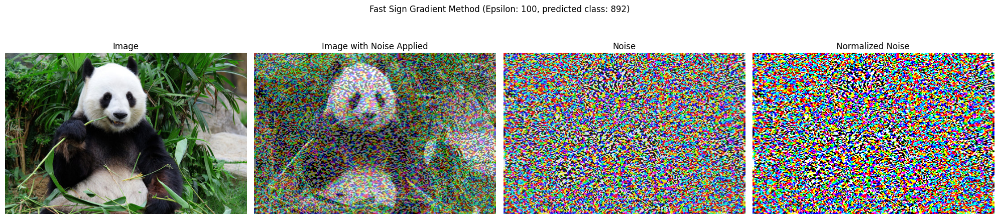

In [ ]:
noises = []
predicted_classes = []
stats = []

for eps in EPSILONS:
    attacker = FastSignGradientMethodAttack(
        model=model,
        preprocessing_fn=PreprocessingFromFunction.create(preprocess),
        epsilon=float(eps),
        binary=False,
        verbose=0,
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=TARGET_CLASS,
        on_original=ON_ORIGINAL,
    )

    stats.append(
    f"Epsilon: {eps}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    f"Noise mean: {np.mean(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0])

for n, pc, s, eps in zip(noises, predicted_classes, stats, EPSILONS):
    print(s)
    Plotting.plot_images_and_noise(image_array,
                                n,
                                config={
                                    "title": f"Fast Sign Gradient Method (Epsilon: {eps}, predicted class: {pc})",
                                })

## BIM And PGD

# Basic Iterative Method / Projected Gradient Descent Attack

This notebook cell runs an adversarial attack using the **Projected Gradient Descent (PGD)** method, also known as the **Basic Iterative Method (BIM)**, on a given input image and visualizes the results.

## Attack Overview

The **Projected Gradient Descent (PGD)** attack is an iterative extension of the Fast Sign Gradient Method (FSGM). It applies small perturbations over multiple steps to gradually push the input toward a misclassification, while ensuring the perturbation stays within a defined epsilon-ball around the original image.

Each iteration involves taking a small step in the direction of the sign of the gradient of the loss with respect to the input, followed by projection back to the epsilon-ball to maintain the constraint:

  **xₜ₊₁ = Πₑ(xₜ + α * sign(∇ₓ J(θ, xₜ, y_target)))**

Where:
- `xₜ` is the perturbed image at step `t`
- `α` is the learning rate (step size per iteration)
- `ε` (epsilon) is the max perturbation allowed
- `Πₑ()` is the projection operator to keep the perturbation within epsilon
- `y_target` is the target class for a targeted attack
- `J` is the loss function

PGD is considered one of the most effective first-order adversaries and is widely used for adversarial training and robustness evaluation.

## Parameters

| Parameter               | Type     | Description |
|-------------------------|----------|-------------|
| `IMAGE`                 | `str`    | Filename of the input image to be attacked. |
| `EPSILON`               | `int`    | Maximum total perturbation allowed. The noise added will not exceed this limit. |
| `EPSILONS`              | `list`   | List of epsilon values for potential experimentation. Not used directly in this cell. |
| `LEARNING_RATE`         | `float`  | Step size for each iteration of the attack. Smaller values provide finer control. |
| `TARGET_CLASS`          | `int`    | Index of the class the attack tries to force the model to predict (targeted attack). |
| `TARGET_CLASS_CONFIDENCE` | `float`  | Desired confidence level in the target class for early stopping. |
| `ON_ORIGINAL`           | `bool`   | If True, the attack is performed on the raw image; if False, it's on the preprocessed image. |
| `VERBOSE`               | `int`    | Controls how much information is printed during attack execution. Higher = more verbose. |
| `EPOCHS`                | `int`    | Maximum number of attack iterations (gradient steps) to run. |


In [ ]:
IMAGE = "jellyfish.jpg"
EPSILON = 2
EPSILONS = [1, 2, 5, 10, 20, 50, 100]
LEARNING_RATE = 1
TARGET_CLASS = 924
TARGET_CLASS_CONFIDENCE = 0.5
ON_ORIGINAL = True
VERBOSE = 3
EPOCHS = 20

In [ ]:
image_path = os.path.join(IMAGES_DIR, IMAGE)
image_array = get_image_array(image_path)

In [ ]:
predictions = model.predict(preprocess(image_array), verbose=0)
print("Predicted class:", decode_predictions(predictions, top=1)[0][0][1])
print("Predicted class index:", np.argmax(predictions, axis=1)[0])
print("Predicted class probability:", np.max(predictions, axis=1)[0])

Predicted class: jellyfish
Predicted class index: 107
Predicted class probability: 0.9484338


Attacking:  70%|███████   | 14/20 [00:15<00:06,  1.08s/it, Loss=1.31, Prediction (score)=924(0.767), Original Class (score)=107(0.006), Target Class (score)=924(0.767)] 

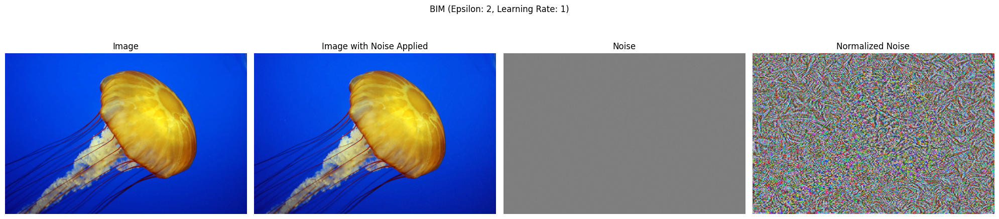

In [ ]:
attacker = ProjectedGradientDescentAttack(
    model=model,
    preprocessing_fn=PreprocessingFromFunction.create(preprocess),
    learning_rate=float(LEARNING_RATE),
    epsilon=float(EPSILON),
    binary=False,
    verbose=VERBOSE,
    callbacks=[EarlyStopping(trigger="misclassification", confidence=0.5)],
)

noise, noise_meta = attacker.attack(
    sample=image_array,
    target_class=TARGET_CLASS,
    on_original=ON_ORIGINAL,
    epochs=EPOCHS
)

Plotting.plot_images_and_noise(image_array,
                               noise,
                               config={
                                   "title": f"BIM (Epsilon: {EPSILON}, Learning Rate: {LEARNING_RATE})",
                               })

In [ ]:
print(
    f"Epsilon: {EPSILON}\n"
    f"Learning Rate: {LEARNING_RATE}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
)

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.7673871517181396
Noise min: -2.0
Noise max: 2.0




Attacking:  40%|████      | 8/20 [00:10<00:16,  1.37s/it, Loss=0.991, Prediction (score)=924(0.944), Original Class (score)=107(0.000), Target Class (score)=924(0.944)]

Attacking:  40%|████      | 8/20 [00:07<00:10,  1.11it/s, Loss=0.991, Prediction (score)=924(0.944), Original Class (score)=107(0.000), Target Class (score)=924(0.944)]

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 107
Adversarial class confidence: 0.1546466052532196
Noise min: -1.0
Noise max: 1.0



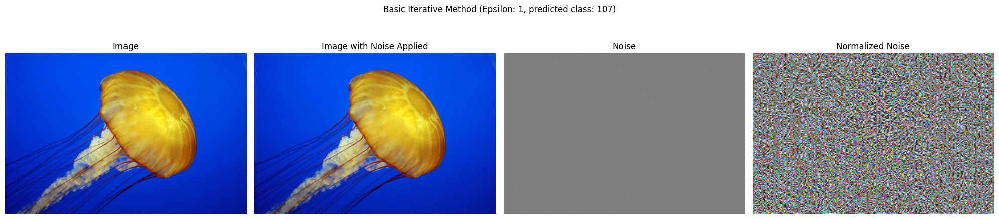

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.7673871517181396
Noise min: -2.0
Noise max: 2.0



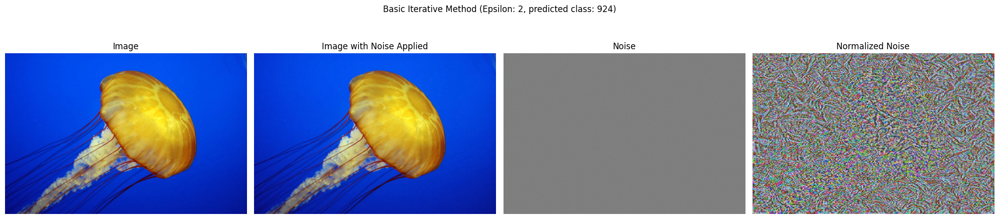

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.8423194289207458
Noise min: -5.0
Noise max: 5.0



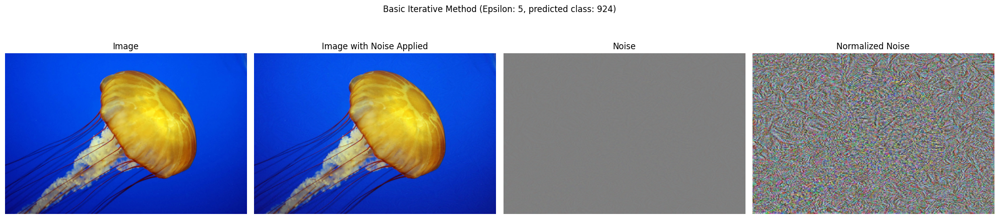

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.9440199732780457
Noise min: -8.0
Noise max: 8.0



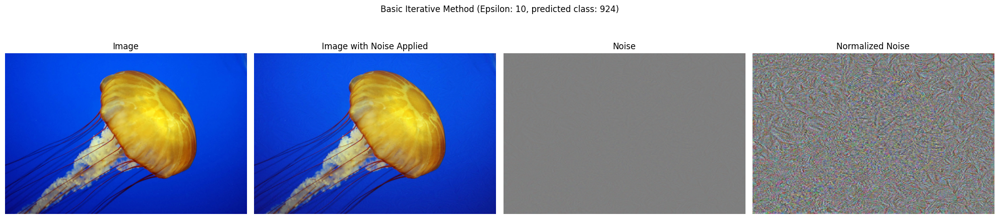

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.9440199732780457
Noise min: -8.0
Noise max: 8.0



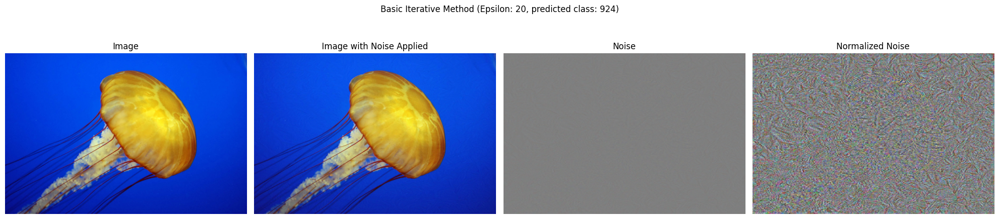

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.9440199732780457
Noise min: -8.0
Noise max: 8.0



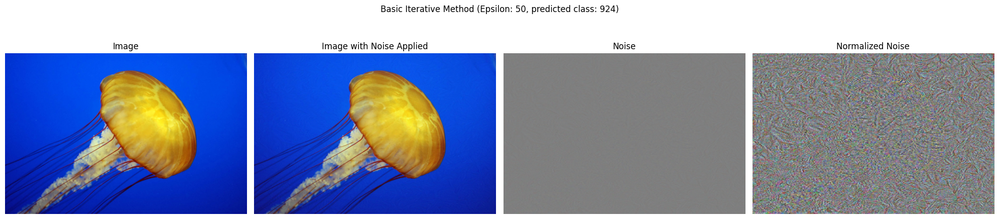

Epsilon: 2
Learning Rate: 1
Original class: 107
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.9440199732780457
Noise min: -8.0
Noise max: 8.0



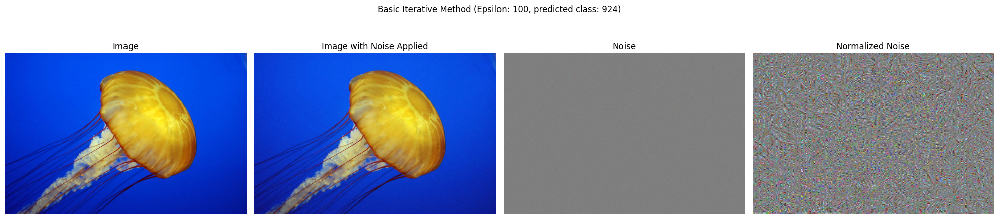

In [ ]:
noises = []
predicted_classes = []
stats = []

for eps in EPSILONS:
    attacker = ProjectedGradientDescentAttack(
    model=model,
    preprocessing_fn=PreprocessingFromFunction.create(preprocess),
    learning_rate=float(LEARNING_RATE),
    epsilon=float(eps),
    binary=False,
    verbose=VERBOSE,
    callbacks=[EarlyStopping(trigger="misclassification", confidence=TARGET_CLASS_CONFIDENCE)],
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=TARGET_CLASS,
        on_original=ON_ORIGINAL,
        epochs=EPOCHS
    )

    stats.append(
    f"Epsilon: {EPSILON}\n"
    f"Learning Rate: {LEARNING_RATE}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0])

for n, pc, s, eps in zip(noises, predicted_classes, stats, EPSILONS):
    print(s)
    Plotting.plot_images_and_noise(image_array,
                                n,
                                config={
                                    "title": f"Basic Iterative Method (Epsilon: {eps}, predicted class: {pc})",
                                })

## Carlini Wagner Attack (C&W)

# Carlini & Wagner (C&W) Attack on Image Classification Model

This notebook cell runs a **Carlini & Wagner (C&W)** adversarial attack on a given input image and visualizes the results.

## Attack Overview

The **Carlini & Wagner (C&W)** attack is a powerful, optimization-based adversarial attack. It formulates the attack as a constrained optimization problem that minimizes the size of the perturbation while ensuring that the model classifies the input as a target class (in a targeted attack).

The attack solves:

  **minimize ||δ||₂² + C * f(x + δ)**

Where:
- `δ` is the perturbation
- `C` is a constant that balances distortion and success of the attack
- `f(x + δ)` is a specially designed loss function that is high when the model does not misclassify, and low when it does
- The perturbation `δ` is optimized using gradient descent
- `kappa` (κ) controls the confidence with which the model is forced into the wrong class

The attack is slow but highly effective, especially for evaluating worst-case robustness.

## Parameters

| Parameter                 | Type     | Description |
|---------------------------|----------|-------------|
| `IMAGE`                   | `str`    | Filename of the input image to be attacked. |
| `C`                       | `float`  | Lagrange multiplier balancing perturbation size vs. misclassification confidence. |
| `C_VALS`                  | `list`   | List of potential `C` values for experimentation. Not used directly in this cell. |
| `KAPPA`                   | `float`  | Confidence parameter for enforcing stronger adversarial misclassification. |
| `LEARNING_RATE`           | `float`  | Step size for the gradient descent optimizer. |
| `TARGET_CLASS`            | `int`    | Class index to which the input should be misclassified. |
| `TARGET_CLASS_CONFIDENCE`| `float`  | Confidence threshold used in early stopping once the target class prediction reaches this level. |
| `ON_ORIGINAL`             | `bool`   | If True, the attack is performed on the original image; otherwise, on the preprocessed image. |
| `VERBOSE`                 | `int`    | Controls verbosity of the attack output. Higher means more logs. |
| `EPOCHS`                  | `int`    | Number of optimization steps (epochs) for the attack. |


In [ ]:
IMAGE = "panda.jpg"
C=50,
C_VALS = [1, 2, 5, 10, 20, 50, 100, 200]
KAPPA=0.5,
LEARNING_RATE = 1
TARGET_CLASS = 924
TARGET_CLASS_CONFIDENCE = 0.5
ON_ORIGINAL = True
VERBOSE = 3
EPOCHS = 20

In [ ]:
image_path = os.path.join(IMAGES_DIR, IMAGE)
image_array = get_image_array(image_path)

In [ ]:
predictions = model.predict(preprocess(image_array), verbose=0)
print("Predicted class:", decode_predictions(predictions, top=1)[0][0][1])
print("Predicted class index:", np.argmax(predictions, axis=1)[0])
print("Predicted class probability:", np.max(predictions, axis=1)[0])

Predicted class: giant_panda
Predicted class index: 388
Predicted class probability: 0.91791797


Attacking:  40%|████      | 8/20 [00:08<00:11,  1.06it/s, Loss=1.24e+3, Prediction (score)=924(0.862), Original Class (score)=388(0.004), Target Class (score)=924(0.862)]

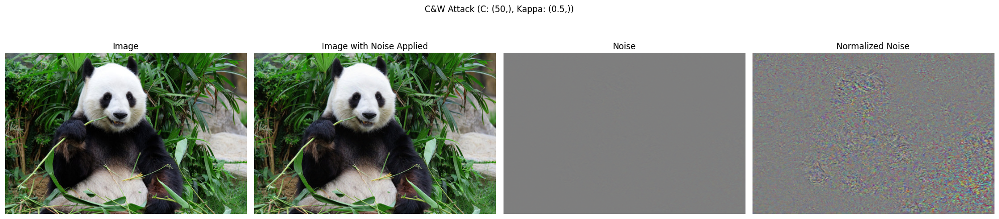

In [ ]:
attacker = CarliniWagnerAttack(
    model=model,
    preprocessing_fn=PreprocessingFromFunction.create(preprocess),
    learning_rate=float(LEARNING_RATE),
    C=C,
    kappa=KAPPA,
    binary=False,
    verbose=VERBOSE,
    callbacks=[EarlyStopping(trigger="misclassification", confidence=TARGET_CLASS_CONFIDENCE)],
)

noise, noise_meta = attacker.attack(
    sample=image_array,
    target_class=TARGET_CLASS,
    on_original=ON_ORIGINAL, # This determines if the attack is performed on the original image or on the preprocessed one
    epochs=EPOCHS
)

Plotting.plot_images_and_noise(image_array,
                               noise,
                               config={
                                   "title": f"C&W Attack (C: {C}, Kappa: {KAPPA})",
                               })

In [ ]:
print(
    f"C: {C}\n"
    f"KAPPA: {KAPPA}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
)

C: (50,)
KAPPA: (0.5,)
Original class: 388
Target class: 924
Adversarial class: 924
Adversarial class confidence: 0.8617820739746094
Noise min: -6.472381591796875
Noise max: 6.585704326629639



In [ ]:
noises = []
predicted_classes = []
stats = []

for c_val in C_VALS:
    attacker = CarliniWagnerAttack(
    model=model,
    preprocessing_fn=PreprocessingFromFunction.create(preprocess),
    learning_rate=float(LEARNING_RATE),
    C=c_val,
    kappa=KAPPA,
    binary=False,
    verbose=VERBOSE,
    callbacks=[EarlyStopping(trigger="misclassification", confidence=0.5)],
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=TARGET_CLASS,
        on_original=ON_ORIGINAL, # This determines if the attack is performed on the original image or on the preprocessed one
        epochs=20
    )

    stats.append(
    f"C: {c_val}\n"
    "Kappa: {KAPPA}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array + noise), verbose=0), axis=1)[0])

for n, pc, s, c_val in zip(noises, predicted_classes, stats, C_VALS):
    print(s)
    Plotting.plot_images_and_noise(image_array,
                                n,
                                config={
                                    "title": f"C&W Attack (C: {c_val}, Kappa: {KAPPA}, predicted class: {pc})",
                                })

Attacking: 100%|██████████| 20/20 [00:18<00:00,  1.05it/s, Loss=338, Prediction (score)=388(0.898), Original Class (score)=388(0.898), Target Class (score)=924(0.000)]

## Deepfool

# DeepFool Attack on Image Classification Model

This notebook cell executes a **DeepFool** adversarial attack on a given input image and visualizes the adversarial noise and result.

## Attack Overview

The **DeepFool** attack is an untargeted, iterative adversarial attack that computes minimal perturbations necessary to change the model's classification. It assumes the model is approximately linear around the current input and iteratively projects the input toward the closest class boundary.

The algorithm stops once the prediction changes to the target class (if specified) or to any incorrect class (untargeted). It then applies a small **overshoot** to ensure misclassification is maintained after discretization.

DeepFool is known for producing extremely small and imperceptible adversarial noise.

## Parameters

| Parameter                 | Type     | Description |
|---------------------------|----------|-------------|
| `IMAGE`                   | `str`    | Filename of the input image to be attacked. |
| `OVERSHOOT`               | `float`  | Amount of overshoot added to ensure the adversarial point crosses the decision boundary. |
| `OVERSHOOT_VALS`          | `list`   | Set of candidate overshoot values for experimentation. Not used directly in this cell. |
| `TARGET_CLASS`            | `int`    | Target class index. DeepFool can be used in both targeted and untargeted settings. |
| `TARGET_CLASS_CONFIDENCE`| `float`  | Confidence threshold for stopping the attack once the target class is predicted with enough confidence. |
| `ON_ORIGINAL`             | `bool`   | Whether to attack the raw image. DeepFool does not support `True`; must be `False`. |
| `VERBOSE`                 | `int`    | Verbosity level; higher value yields more log output. |
| `EPOCHS`                  | `int`    | Maximum number of iterations to perform for the attack. |
| `EFFICIENT_MODE`          | `int`    | Optimization parameter to trade off speed vs. precision. Lower values may yield finer results. |


In [ ]:
IMAGE = "panda.jpg"
OVERSHOOT = 0.1
OVERSHOOT_VALS = [0.1, 0.25, 0.5]
TARGET_CLASS = 924
TARGET_CLASS_CONFIDENCE = 0.3
ON_ORIGINAL = False                     # Deep Fool does not support on_original=True
VERBOSE = 3
EPOCHS = 20
EFFICIENT_MODE = 20

In [ ]:
image_path = os.path.join(IMAGES_DIR, IMAGE)
image_array = get_image_array(image_path)

In [ ]:
predictions = model.predict(preprocess(image_array), verbose=0)
print("Predicted class:", decode_predictions(predictions, top=1)[0][0][1])
print("Predicted class index:", np.argmax(predictions, axis=1)[0])
print("Predicted class probability:", np.max(predictions, axis=1)[0])

In [ ]:
early_stopping = EarlyStopping(trigger="misclassification", confidence=0.2)
preprocessing_fn = PreprocessingFromFunction.create(preprocess)

attacker = DeepFoolAttack(
    model=model,
    preprocessing_fn=preprocessing_fn,
    epsilon=EPSILON,
    overshoot=OVERSHOOT,
    callbacks=[early_stopping],
    efficient_mode=EFFICIENT_MODE,
)

noise, noise_meta = attacker.attack(
    sample=image_array,
    target_class=924,
    on_original=ON_ORIGINAL,
    epochs=EPOCHS,
)

Plotting.plot_images_and_noise(preprocessing_fn.preprocess(image_array).numpy(),
                               noise,
                               config={
                                   "title": f"Deep Fool (Overshoot: {OVERSHOOT})",
                               })

In [ ]:
print(
    f"Overshoot: {OVERSHOOT}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
)

In [ ]:
noises = []
predicted_classes = []
stats = []

for o_val in OVERSHOOT_VALS:
    early_stopping = EarlyStopping(trigger="misclassification", confidence=0.2)
    preprocessing_fn = PreprocessingFromFunction.create(preprocess)

    attacker = DeepFoolAttack(
        model=model,
        preprocessing_fn=preprocessing_fn,
        epsilon=EPSILON,
        overshoot=OVERSHOOT,
        callbacks=[early_stopping],
        efficient_mode=EFFICIENT_MODE,
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=924,
        on_original=ON_ORIGINAL,
        epochs=EPOCHS
    )

    stats.append(
    f"Overshoot: {o_val}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0])

for n, pc, s, o_val in zip(noises, predicted_classes, stats, OVERSHOOT_VALS):
    print(s)
    Plotting.plot_images_and_noise(preprocessing_fn.preprocess(image_array).numpy(),
                                n,
                                config={
                                    "title": f"Deep Fool (Overshoot: {o_val}, predicted class: {pc})",
                                })

## Smooth Fool

# SmoothFool Attack on Image Classification Model

This notebook cell runs a **SmoothFool** adversarial attack on a given input image and visualizes the adversarial noise.

## Attack Overview

**SmoothFool** is an extension of the DeepFool attack that generates **spatially smooth** adversarial perturbations. It introduces a regularization component based on Gaussian smoothing to make the perturbation visually coherent and more realistic, helping bypass some types of defenses that detect noisy perturbations.

The attack iteratively perturbs the image toward misclassification by applying smoothed gradients, while maintaining minimal and imperceptible distortion. Like DeepFool, it assumes the classifier behaves linearly near the input.

SmoothFool is particularly useful for creating adversarial examples that are harder to detect and more transferable.

## Parameters

| Parameter                 | Type     | Description |
|---------------------------|----------|-------------|
| `IMAGE`                   | `str`    | Filename of the input image to be attacked. |
| `OVERSHOOT`               | `float`  | Amount of overshoot applied to ensure crossing of decision boundary. |
| `SIGMA`                   | `float`  | Standard deviation of the Gaussian filter for smoothing perturbation. Controls smoothness. |
| `SIGMA_VALS`              | `list`   | Range of values for `SIGMA` used for experimentation. Not used in this cell. |
| `KERNEL_SIZE`             | `int`    | Size of the Gaussian kernel used for smoothing. Must be odd. |
| `KERNEL_SIZE_VALS`        | `list`   | List of kernel sizes for experimentation. Not used in this cell. |
| `TARGET_CLASS`            | `int`    | Target class index for the targeted attack. |
| `TARGET_CLASS_CONFIDENCE`| `float`  | Confidence threshold used for early stopping. |
| `ON_ORIGINAL`             | `bool`   | Must be `False`. SmoothFool does not support attacking the original image directly. |
| `VERBOSE`                 | `int`    | Controls the verbosity of the attack process. |
| `EPOCHS`                  | `int`    | Maximum number of iterations the attack will run. |
| `EFFICIENT_MODE`          | `int`    | Controls optimization performance; lower values improve precision at the cost of speed. |


In [ ]:
IMAGE = "panda.jpg"
OVERSHOOT = 0.1
SIGMA = 0.5
SIGMA_VALS = [0.1, 0.25, 0.5, 0.8]
KERNEL_SIZE = 3
KERNEL_SIZE_VALS = [3, 5, 7, 9, 11]
TARGET_CLASS = 924
TARGET_CLASS_CONFIDENCE = 0.3
ON_ORIGINAL = False                     # Smooth Fool does not support on_original=True
VERBOSE = 3
EPOCHS = 20
EFFICIENT_MODE = 20

In [ ]:
image_path = os.path.join(IMAGES_DIR, IMAGE)
image_array = get_image_array(image_path)

In [ ]:
predictions = model.predict(preprocess(image_array), verbose=0)
print("Predicted class:", decode_predictions(predictions, top=1)[0][0][1])
print("Predicted class index:", np.argmax(predictions, axis=1)[0])
print("Predicted class probability:", np.max(predictions, axis=1)[0])

In [ ]:
early_stopping = EarlyStopping(trigger="misclassification", confidence=0.2)
preprocessing_fn = PreprocessingFromFunction.create(preprocess)

attacker = SmoothFoolAttack(
    model=model,
    preprocessing_fn=preprocessing_fn,
    epsilon=EPSILON,
    overshoot=OVERSHOOT,
    sigma=SIGMA,
    kernel_size=KERNEL_SIZE,
    callbacks=[early_stopping],
    efficient_mode=EFFICIENT_MODE,
)

noise, noise_meta = attacker.attack(
    sample=image_array,
    target_class=924,
    epochs=EPOCHS,
)

Plotting.plot_images_and_noise(preprocessing_fn.preprocess(image_array).numpy(), noise)

In [ ]:
print(
    f"Overshoot: {OVERSHOOT}\n"
    f"Sigma: {SIGMA}\n"
    f"Kernel size: {KERNEL_SIZE}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
)

In [ ]:
noises = []
predicted_classes = []
stats = []

for s_val in SIGMA_VALS:
    early_stopping = EarlyStopping(trigger="misclassification", confidence=0.2)
    preprocessing_fn = PreprocessingFromFunction.create(preprocess)

    attacker = SmoothFoolAttack(
        model=model,
        preprocessing_fn=preprocessing_fn,
        epsilon=EPSILON,
        overshoot=OVERSHOOT,
        sigma=s_val,
        kernel_size=KERNEL_SIZE,
        callbacks=[early_stopping],
        efficient_mode=EFFICIENT_MODE,
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=924,
        epochs=EPOCHS,
    )

    stats.append(
    f"Overshoot: {OVERSHOOT}\n"
    f"Sigma: {SIGMA}\n"
    f"Kernel size: {KERNEL_SIZE}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0])

for n, pc, s, sig in zip(noises, predicted_classes, stats, SIGMA_VALS):
    print(s)
    Plotting.plot_images_and_noise(preprocessing_fn.preprocess(image_array).numpy(),
                                n,
                                config={
                                    "title": f"Smooth Fool (Overshoot: {eps}, Sigma: {sig}, Kernel size: {KERNEL_SIZE}, predicted class: {pc})",
                                })

In [ ]:
noises = []
predicted_classes = []
stats = []
for K_val in KERNEL_SIZE_VALS:
    early_stopping = EarlyStopping(trigger="misclassification", confidence=0.2)
    preprocessing_fn = PreprocessingFromFunction.create(preprocess)

    attacker = SmoothFoolAttack(
        model=model,
        preprocessing_fn=preprocessing_fn,
        epsilon=EPSILON,
        overshoot=OVERSHOOT,
        sigma=SIGMA,
        kernel_size=K_val,
        callbacks=[early_stopping],
        efficient_mode=EFFICIENT_MODE,
    )

    noise, noise_meta = attacker.attack(
        sample=image_array,
        target_class=924,
        epochs=EPOCHS,
    )

    stats.append(
    f"Overshoot: {OVERSHOOT}\n"
    f"Sigma: {SIGMA}\n"
    f"Kernel size: {KERNEL_SIZE}\n"
    f"Original class: {np.argmax(model.predict(preprocess(image_array), verbose=0), axis=1)[0]}\n"
    f"Target class: {TARGET_CLASS}\n"
    f"Adversarial class: {np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Adversarial class confidence: {np.max(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0]}\n"
    f"Noise min: {np.min(noise)}\n"
    f"Noise max: {np.max(noise)}\n"
    )

    noises.append(noise)
    predicted_classes.append(np.argmax(model.predict(preprocess(image_array) + noise, verbose=0), axis=1)[0])

for n, pc, s, ker in zip(noises, predicted_classes, stats, KERNEL_SIZE_VALS):
    print(s)
    Plotting.plot_images_and_noise(preprocessing_fn.preprocess(image_array).numpy(),
                                n,
                                config={
                                    "title": f"Smooth Fool (Overshoot: {eps}, Sigma: {SIGMA}, Kernel size: {ker}, predicted class: {pc})",
                                })

# Blackbox Attacks

## Setup

# Black-Box Misclassification Attack Configuration

This block sets up a **Black-Box Misclassification Attack** using gradient-free optimization and estimated gradients. The attack is designed to work without access to the model's internal gradients by approximating them with finite difference techniques.

## Attack Overview

The **BlackBoxMisclassificationAttack** is a general-purpose black-box adversarial attack that works by querying the model and estimating the direction in which to modify the input to cause misclassification. It supports targeted and untargeted attacks and can be configured with different gradient estimators.

In this configuration, the attack:
- Uses **Projected Gradient Descent (PGD)** as the optimizer.
- Estimates gradients using **Finite Difference (FD)** with random block-wise perturbations.
- Adds **zero noise** to initialize adversarial samples.
- Enforces that all generated adversarial samples stay within valid pixel bounds (`[0, 255]`).
- Stops early once the input is misclassified as the **target class** with at least 50% confidence.

This attack is useful in realistic threat models where access to gradients is restricted or unavailable.

## Parameters

| Parameter                   | Type       | Description |
|-----------------------------|------------|-------------|
| `loss`                      | `CategoricalCrossEntropy` | Loss function used to guide the attack. |
| `optimizer`                 | `PGD`      | Optimizer for minimizing the loss. |
| `constrain2`                | `PONoisedSampleBounding` | Ensures pixel values remain in the valid range [0, 255]. |
| `constraints`               | `list`     | List of constraints applied to the adversarial sample. |
| `noise_generator`          | `AdditiveNoiseGenerator` | Initializes adversarial samples with noise. Here, initialized to zeros. |
| `early_stopping_targetted` | `EarlyStopping` | Stops the attack when the input is classified as target class with sufficient confidence. |
| `early_stopping_non_targetted` | `EarlyStopping` | Stops the attack when the input is misclassified (for untargeted attacks). |
| `gradient_estimator`       | `FDGradientEstimator` | Approximates gradients using finite differences and block-wise perturbations. |
| `attacker`                 | `BlackBoxMisclassificationAttack` | Complete attacker instance configured with all components. |


# Gradient Estimators for Black-Box Attacks

Black-box attacks require estimating gradients without access to model internals. These estimators approximate the gradient direction by querying the model with slightly perturbed inputs.

Below is an explanation of each supported estimator:

---

### 1. `FDGradientEstimator` (Finite Difference Estimator)

**Description**: Approximates the gradient by computing the finite differences between function outputs along certain input directions.

**Key Parameters**:

| Parameter         | Description |
|-------------------|-------------|
| `epsilon`         | Size of the perturbation used for finite difference computation. |
| `max_perturbations` | Maximum number of input directions probed per iteration. |
| `batch_size`      | Number of perturbations processed in parallel. |
| `block_size`      | Size of the input block to perturb. |
| `block_pattern`   | Strategy to choose which blocks to perturb (`random`, `grid`, etc.). |

**Pros**:
- Flexible and effective for small input sizes or localized perturbations.

**Cons**:
- Expensive on high-dimensional data (e.g., images).

---

### 2. `NESGradientEstimator` (Natural Evolution Strategies)

**Description**: Estimates gradients using randomized search directions and expected gradients over noise.

**Key Parameters**:

| Parameter | Description |
|-----------|-------------|
| `sigma`   | Standard deviation of Gaussian noise used to perturb the input. |

**Pros**:
- Scales well with high-dimensional inputs.
- Good for query-efficient attacks.

**Cons**:
- High variance in gradient estimates if not tuned well.

---

### 3. `SPSAGradientEstimator` (Simultaneous Perturbation Stochastic Approximation)

**Description**: Estimates gradients using only two function evaluations, regardless of input dimension.

**Key Parameters**:

| Parameter | Description |
|-----------|-------------|
| `epsilon` | Perturbation size for input directions. |

**Pros**:
- Very efficient; suitable for high-dimensional data.
- Only 2 queries needed per estimate.

**Cons**:
- Very noisy gradient estimates.
- Sensitive to hyperparameters.

---

### 4. `RGFGradientEstimator` (Random Gradient-Free Estimator)

**Description**: Uses random Gaussian directions to estimate gradients using symmetric finite differences.

**Key Parameters**:

| Parameter | Description |
|-----------|-------------|
| `epsilon` | Size of the symmetric perturbation. |

**Pros**:
- Effective in practice with random direction sampling.
- Balances efficiency and accuracy.

**Cons**:
- More queries than SPSA, less efficient than NES for large input spaces.



In [ ]:
!git clone https://github.com/pavanreddyml/adversarial-lab.git
!pip install -e adversarial-lab

In [ ]:
from adversarial_lab.core.optimizers import PGD
from adversarial_lab.callbacks import EarlyStopping
from adversarial_lab.core.losses import CategoricalCrossEntropy
from adversarial_lab.attacker.inference import BlackBoxMisclassificationAttack
from adversarial_lab.core.gradient_estimator import FDGradientEstimator, NESGradientEstimator, SPSAGradientEstimator, RGFGradientEstimator
from adversarial_lab.core.noise_generators.tensor import AdditiveNoiseGenerator
from adversarial_lab.core.preprocessing import PreprocessingFromFunction
from adversarial_lab.core.constraints import POClip, PONoisedSampleBounding

from adversarial_lab.utils import Plotting

import os
from PIL import Image
import matplotlib.pyplot as plt

import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image

In [ ]:
MODEL = "mnist_digits"

if MODEL == "mnist_digits":
    DIGIT = 1
    IMAGE = 1
    MODEL_PATH = f"SquadCon-Workshop-2025/models/{MODEL}.h5"
    IMAGE_PATH = f"SquadCon-Workshop-2025/data/digits/{DIGIT}/{IMAGE}.png"

In [ ]:
model = tf.keras.models.load_model(MODEL_PATH)

def pred_fn(samples, *args, **kwargs):
    samples = np.array(samples)
    preds = model.predict(samples, verbose=0)
    return [pred for pred in preds]

In [ ]:
image = Image.open(IMAGE_PATH)
image_array = np.array(image)

predictions = pred_fn([image_array])
print(f"Predicted class: {np.argmax(predictions)}")
print(f"True class: {DIGIT}")
print(f"Predicticted Class Probability: {np.max(predictions)}")

In [ ]:
loss = CategoricalCrossEntropy()
optimizer = PGD(learning_rate=1.0)

constraint = PONoisedSampleBounding(min=0, max=255)
constraints = [constraint]

noise_generator = AdditiveNoiseGenerator(scale=[0, 255], dist="zeros")

early_stopping_non_targetted = EarlyStopping(trigger="misclassification")
early_stopping_targetted = EarlyStopping(trigger="misclassification", target_class=2, confidence=0.5)

In [ ]:
gradient_estimator = FDGradientEstimator(epsilon=255, max_perturbations=10000, batch_size=32, block_size=9, block_pattern="random")
# gradient_estimator = NESGradientEstimator(sigma=0.7)
# gradient_estimator = SPSAGradientEstimator(epsilon=20)
# gradient_estimator = RGFGradientEstimator(epsilon=20)

In [ ]:
attacker = BlackBoxMisclassificationAttack(
    model=pred_fn,
    optimizer=optimizer,
    loss=loss,
    noise_generator=noise_generator,
    constraints=constraints,
    gradient_estimator=gradient_estimator,
    callbacks=[early_stopping_targetted],
    verbose=3)

In [ ]:
noise, noise_meta = attacker.attack(image_array,
                        target_class=2,
                        epochs=100,
                        on_original=True)

In [ ]:
Plotting.plot_images_and_noise(image_array, noise)

In [ ]:
IMAGES_DIR = os.path.join("FLAIRS-38-Material", "data", "digits")     # Directory containing the images
MODEL_DIR = os.path.join("FLAIRS-38-Material", "models")               # Directory containing the model
DIGIT = 1
IMAGE_NAME = "1.png"